Trajectory Analysis for T.4_Nr4a1 cell sub type for single cell RNA sequencing data for SKG mice Rheumatoid Arthritis Project

Last Updated on: August 10, 2021

# Import packages

In [1]:
import scvelo as scv
#import loompy
import velocyto as vcy
import numpy as np
import scanpy as sc
scv.set_figure_params('scvelo')
import pandas as pd

import scipy
import seaborn as sns
import matplotlib.pyplot as plt

scv.settings.set_figure_params(dpi=150)
sc.settings.set_figure_params(dpi=200)

from pygam import LinearGAM
import matplotlib.pyplot as plt
import seaborn as sns

import numpy as np
from sklearn.datasets.samples_generator import make_blobs
from sklearn.mixture import GaussianMixture
from matplotlib import pyplot as plt
import seaborn as sns
sns.set()

In [2]:
import sklearn
print(sklearn.__version__)
import pygam
print(pygam.__version__)

0.23.1
0.8.0


In [3]:
import matplotlib
cmap = matplotlib.colors.LinearSegmentedColormap.from_list(name='gene_cmap', colors=['lightgrey', 'thistle', 'red', 'darkred'])

In [3]:
scv.logging.print_versions()

scvelo==0.2.1  scanpy==1.5.1  anndata==0.7.4  loompy==2.0.17  numpy==1.18.5  scipy==1.5.0  matplotlib==3.2.2  sklearn==0.23.1  pandas==1.0.5  

In [4]:
scv.settings.set_figure_params(dpi=300)

In [5]:
import loompy
print(loompy.__version__)

2.0.17


# Load Data

In [6]:

#file_path_prefix = #Fill in path to output files from velocyto

file_paths = ["/Lane1_1a_SKG_CD4Naive_GFPhi_Aug17_10xVDJ_5GEXL_2018_09_05", \
              "/Lane2_1b_SKG_CD4Naive_GFPlo_Aug17_10xVDJ_5GEXL_2018_09_05", \
"/Lane3_2a_WT_CD4Naive_GFPhi_Aug17_10xVDJ_5GEXL_2018_09_05", \
"/Lane4_2b_WT_CD4Naive_GFPlo_Aug17_10xVDJ_5GEXL_2018_09_05", \
"/Lane5_3a_SKG_CD4Naive_GFPhi_Aug17_10xVDJ_5GEXL_2018_09_05", \
"/Lane6_3b_SKG_CD4Naive_GFPlo_Aug17_10xVDJ_5GEXL_2018_09_05", \
"/Lane7_4a_WT_CD4Naive_GFPhi_Aug17_10xVDJ_5GEXL_2018_09_05", \
"/Lane8_4b_WT_CD4Naive_GFPlo_Aug17_10xVDJ_5GEXL_2018_09_05"]
loom_names = ["/possorted_genome_bam_XAPK3.loom", \
              "/possorted_genome_bam_8MVJ3.loom", \
              "/possorted_genome_bam_RS8F3.loom", \
              "/possorted_genome_bam_7OTZP.loom", \
              "/possorted_genome_bam_0XF3O.loom", \
              "/possorted_genome_bam_PTZYW.loom", \
              "/possorted_genome_bam_G2WFV.loom", \
              "/possorted_genome_bam_RZMYL.loom"]
adata_velo = [None] * len(file_paths)


for i,file_path in enumerate(file_paths):
    file = file_path_prefix + file_path + file_path + "_velocyto" + loom_names[i]
    adata_velo[i] = scv.read(file, validate=False )



Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [7]:
for i,adata in enumerate(adata_velo):
    adata.obs.index = [x.split(":")[1][:-1] + "-1" for x in adata.obs.index]
    adata_velo[i] = adata

In [8]:
for i,adata in enumerate(adata_velo):
    adata.obs.index = [x + "-" + str(i) for x in adata.obs.index]
    adata_velo[i] = adata
    adata_velo[i].var_names_make_unique()

In [2]:
path = 'adata_object/'
adata_file = path + 'adata_only_T_cells.h5ad'
adata_RNA = sc.read(adata_file)
print("done")

done


In [99]:
np.sum(adata_RNA.var['highly_variable'])

1119

In [4]:
# #Optional - load processed data
# path = 'adata_object/'

# adata_file = path + 'single_cell_scvelo_T_4_Nr4a1_cluster.h5ad'
# adata_merged_all = scv.read(adata_file)

# UMAPs for Egr2 and Tnfrsf9 expression

In [8]:
cmap = matplotlib.colors.LinearSegmentedColormap.from_list(name='gene_cmap', colors=['lightgrey', 'thistle', 'red', 'darkred'])

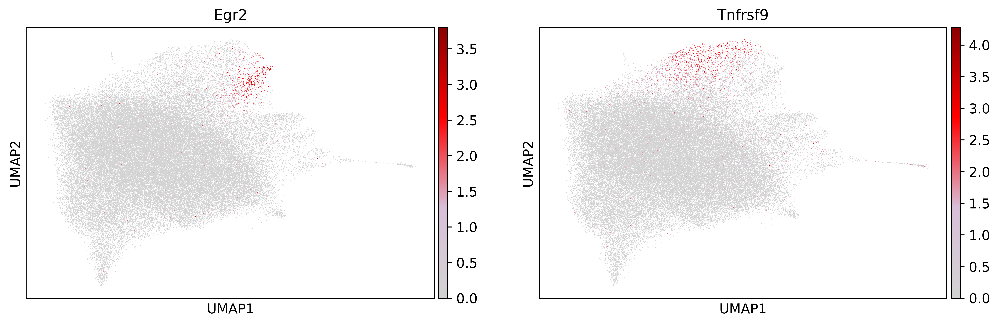

In [99]:
sc.pl.umap(adata_RNA, color = ['Egr2','Tnfrsf9'], cmap = cmap, use_raw = True)

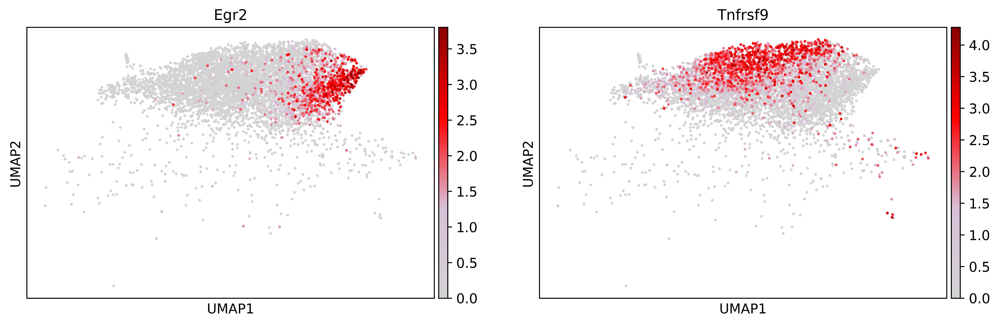

In [100]:
sc.pl.umap(adata_RNA[adata_RNA.obs['leiden'] == '7'], color = ['Egr2','Tnfrsf9'], cmap = cmap, use_raw = True)

# Merge data and run scvelo in dynamical mode

In [10]:
#Group cells in SKG High and WT High subgroup

adata_merged = adata_velo[0].concatenate(adata_velo[4],adata_velo[2],adata_velo[6],index_unique = None )


In [29]:
#Just Nr4a1 High clustr
adata_merged_all = adata_velo[0].concatenate(adata_velo[1],adata_velo[2],adata_velo[3],adata_velo[4],adata_velo[5],adata_velo[6],adata_velo[7],index_unique = None )
adata_merged_all  = adata_merged_all[adata_RNA[adata_RNA.obs['cell_types'] == '3'].obs.index,:]
adata_merged_all = scv.utils.merge(adata_RNA, adata_merged_all)

scv.pp.filter_and_normalize(adata_merged_all, min_shared_counts=20, n_top_genes=2000)
scv.pp.moments(adata_merged_all, n_pcs=30, n_neighbors=30)

scv.tl.recover_dynamics(adata_merged_all)
scv.tl.velocity(adata_merged_all, mode='dynamical')
scv.tl.velocity_graph(adata_merged_all)
scv.tl.velocity_pseudotime(adata_merged_all)
scv.tl.latent_time(adata_merged_all)

Filtered out 279 genes that are detected 20 counts (shared).
Normalized count data: spliced, unspliced.
Skip filtering by dispersion since number of variables are less than `n_top_genes`
computing neighbors
    finished (0:00:01) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of spliced/unspliced abundances (adata.layers)
recovering dynamics
    finished (0:03:34) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing velocities
    finished (0:00:01) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:05) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing terminal states
    identified 4 regions of root cells and 1 region of end points 
    finished (0:00:00) --> added
    'root_cells', root

# UMAP overlays

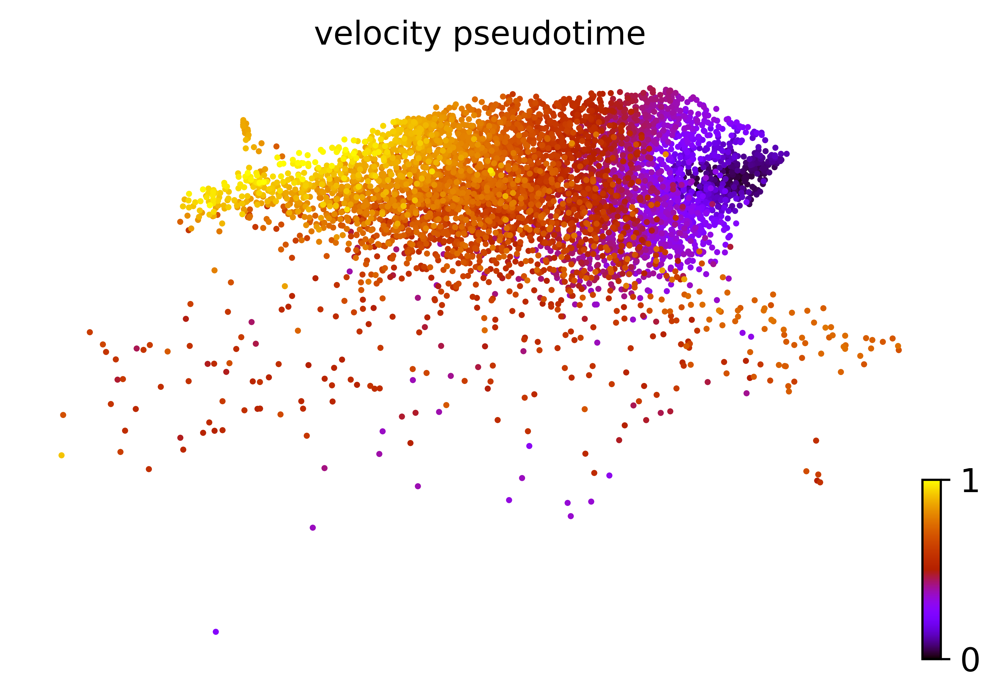

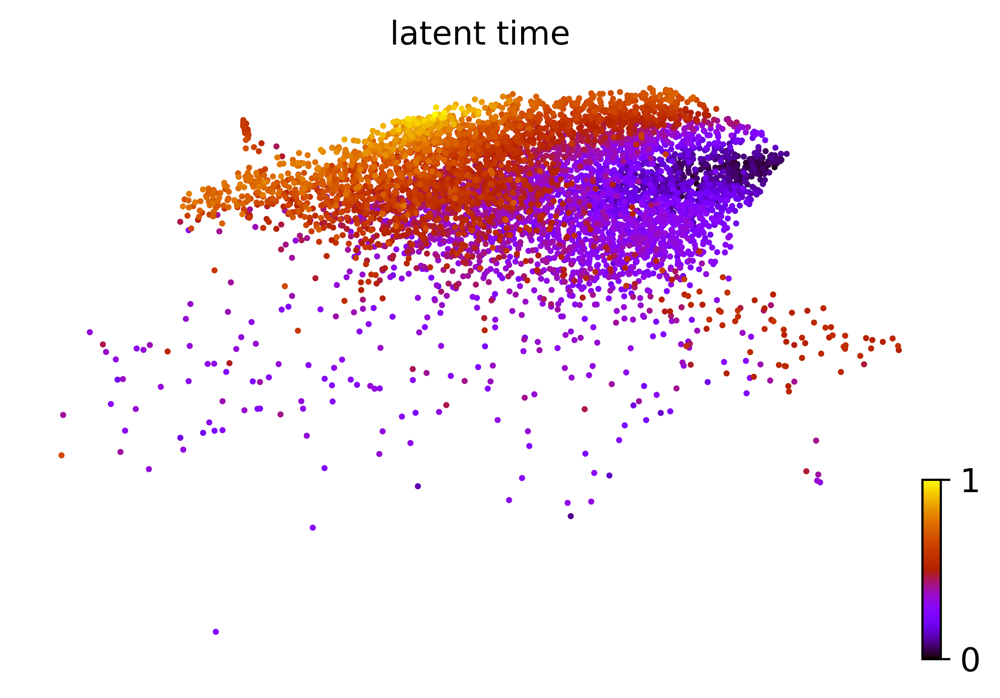

computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


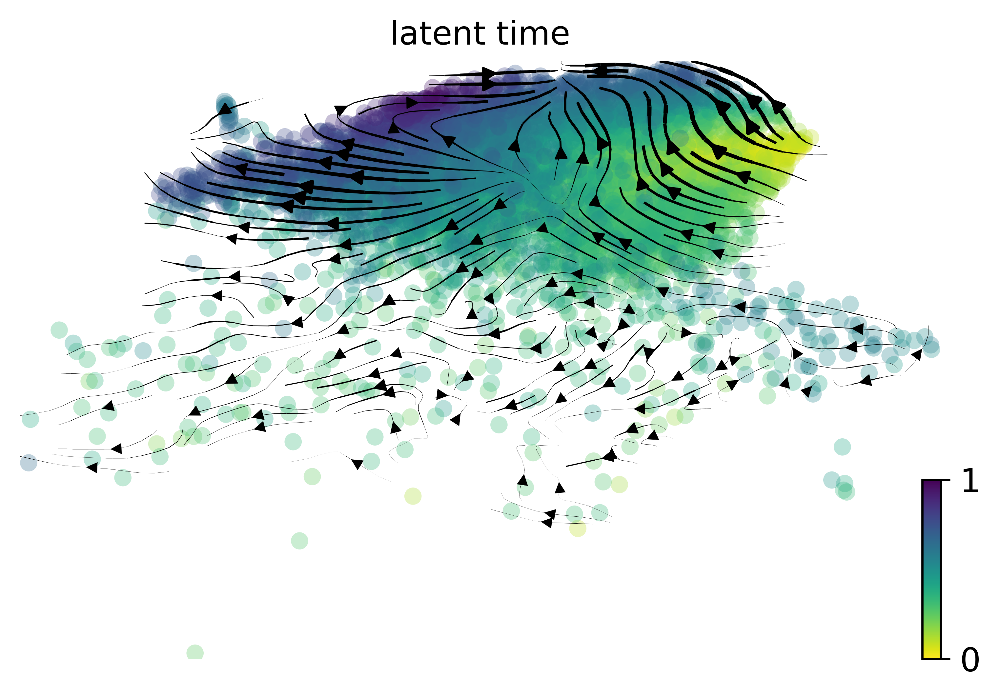

In [30]:

scv.pl.scatter(adata_merged_all, color='velocity_pseudotime', cmap='gnuplot')
scv.pl.scatter(adata_merged_all, color='latent_time', cmap='gnuplot')
scv.pl.velocity_embedding_stream(adata_merged_all, basis='umap', color = 'latent_time')

saving figure to file ./figures/scvelo_fig3_umap_Nr4a1_high_cluster_latent_time.svg


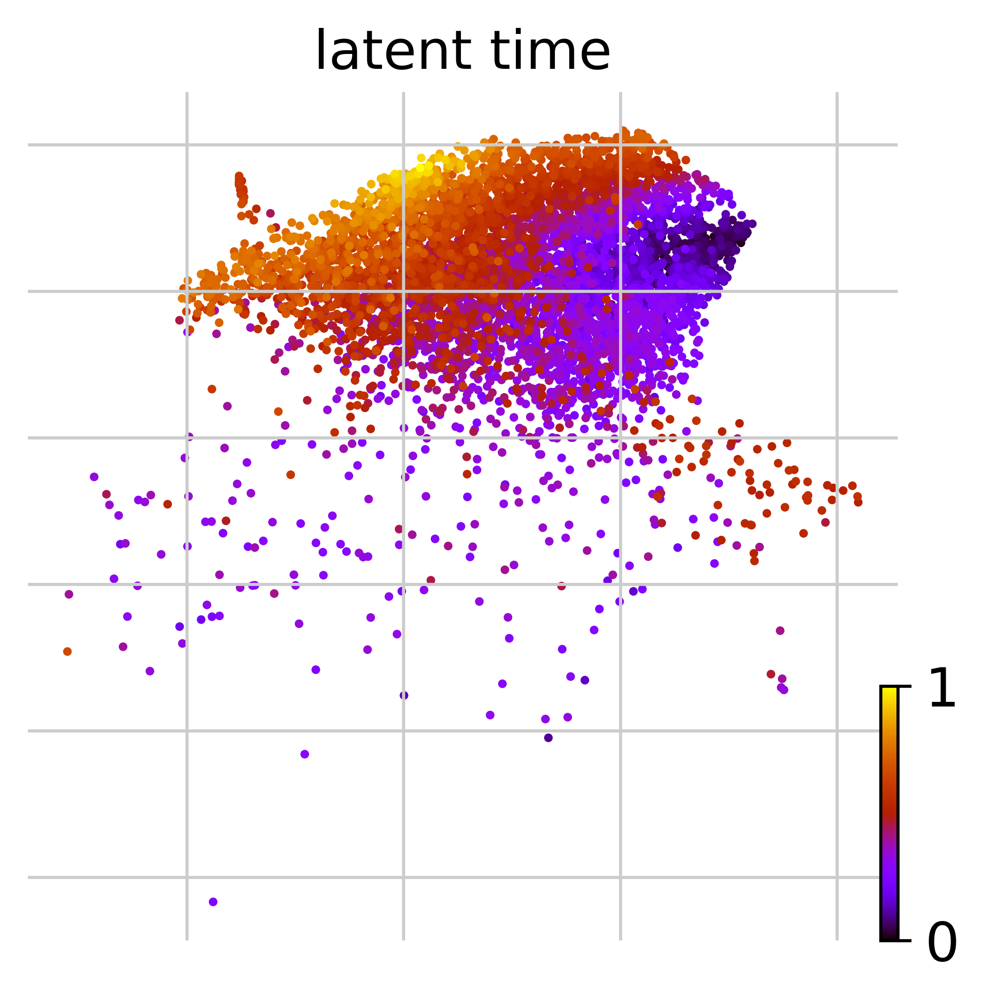

In [37]:
scv.pl.scatter(adata_merged_all, color='latent_time', cmap='gnuplot')#, save = "fig3_umap_Nr4a1_high_cluster_latent_time.svg")

In [101]:
np.corrcoef(adata_merged_all.obs['velocity_pseudotime'], adata_merged_all.obs['latent_time'])


array([[1.        , 0.83694514],
       [0.83694514, 1.        ]])

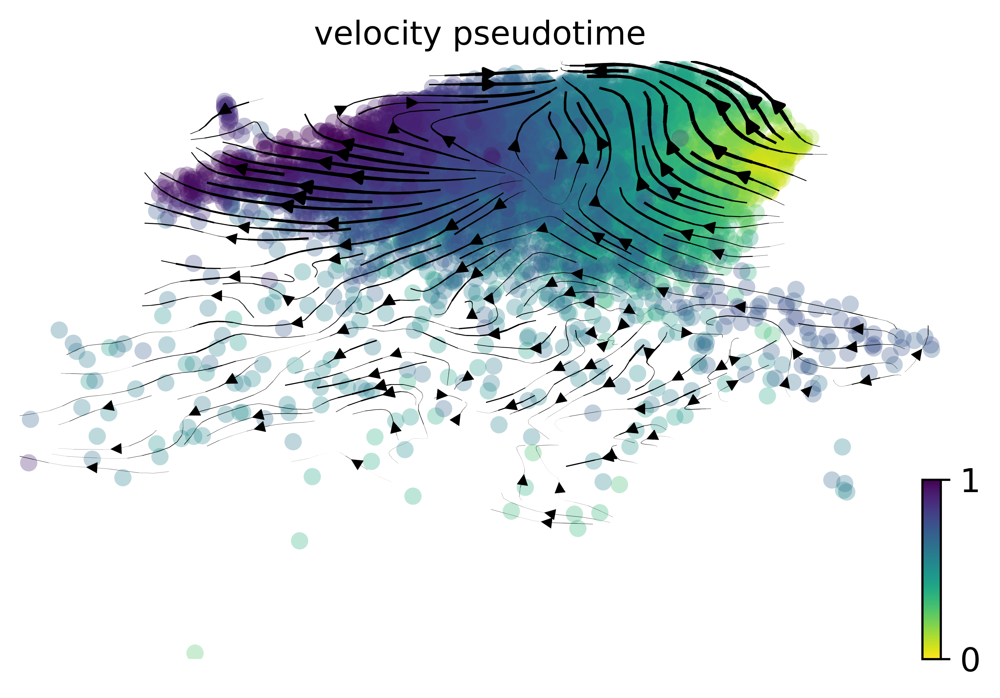

In [33]:
scv.pl.velocity_embedding_stream(adata_merged_all, basis='umap', color = 'velocity_pseudotime')

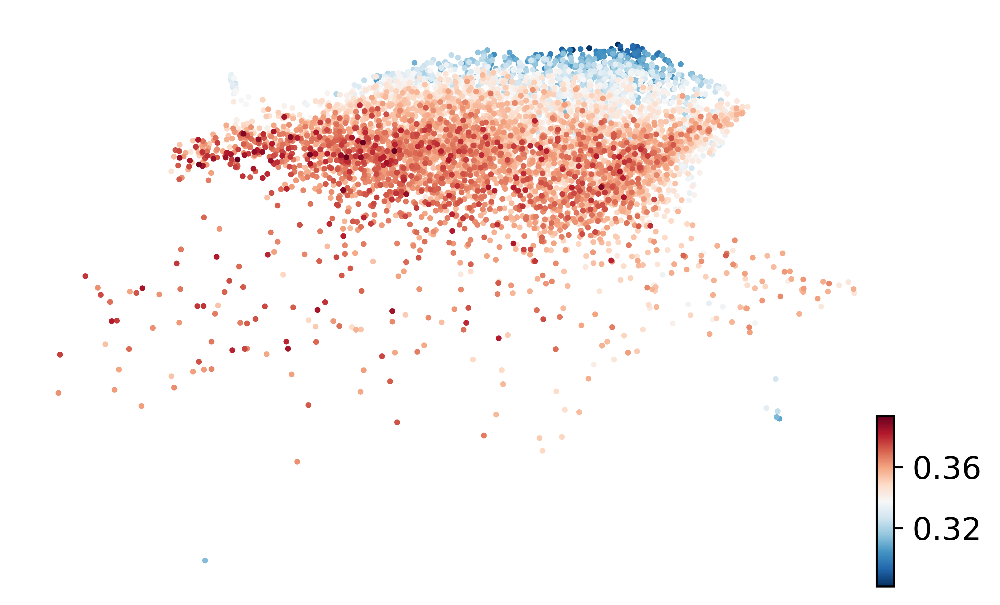

In [31]:
counts_s = scv.utils.sum_var(adata_merged_all.layers['spliced'])
counts_u = scv.utils.sum_var(adata_merged_all.layers['unspliced'])
fractions_u = counts_u / (counts_s + counts_u)
scv.pl.scatter(adata_merged_all, color=fractions_u, smooth=True)

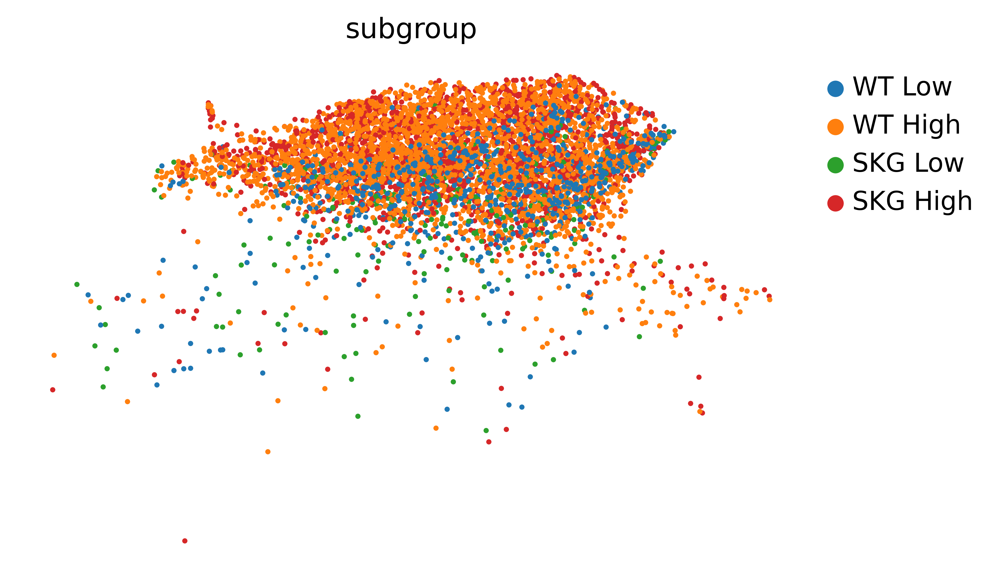

In [53]:
scv.pl.scatter(adata_merged_all, color='subgroup', smooth=True)

# Visualize latent time distributions

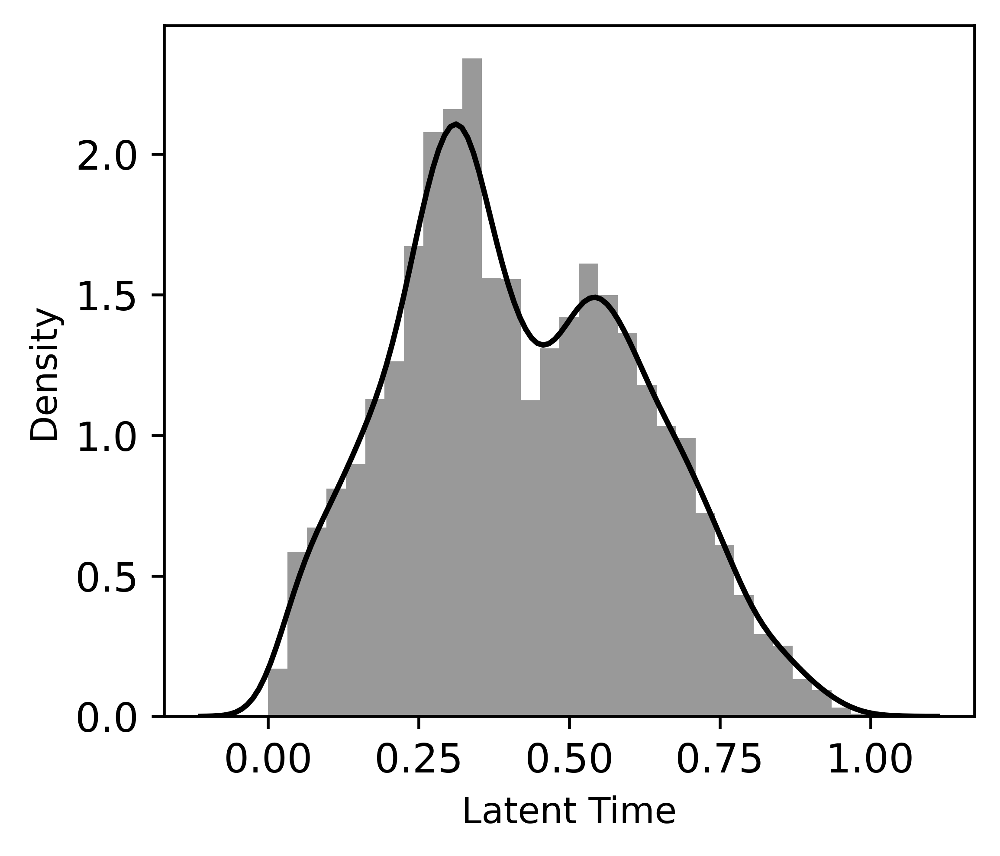

In [10]:

plt.figure(figsize = (4,3.5))
sample_1 = np.array(adata_merged_all.obs['latent_time'])
sns.distplot(sample_1, kde=True, hist = True, color = 'black')
file_save_prefix = "/wynton/group/ye/emccarthy/EM/judy_proj/proj_2_mouse_T_cell_001/figures/supp_fig/"

plt.xlabel("Latent Time",  fontsize = 10)
plt.ylabel("Density",  fontsize = 10 )
plt.savefig(file_save_prefix + "supp_fig_3E_latent_time_probability_density_all_cells.svg", format="svg")
plt.show()
plt.close()

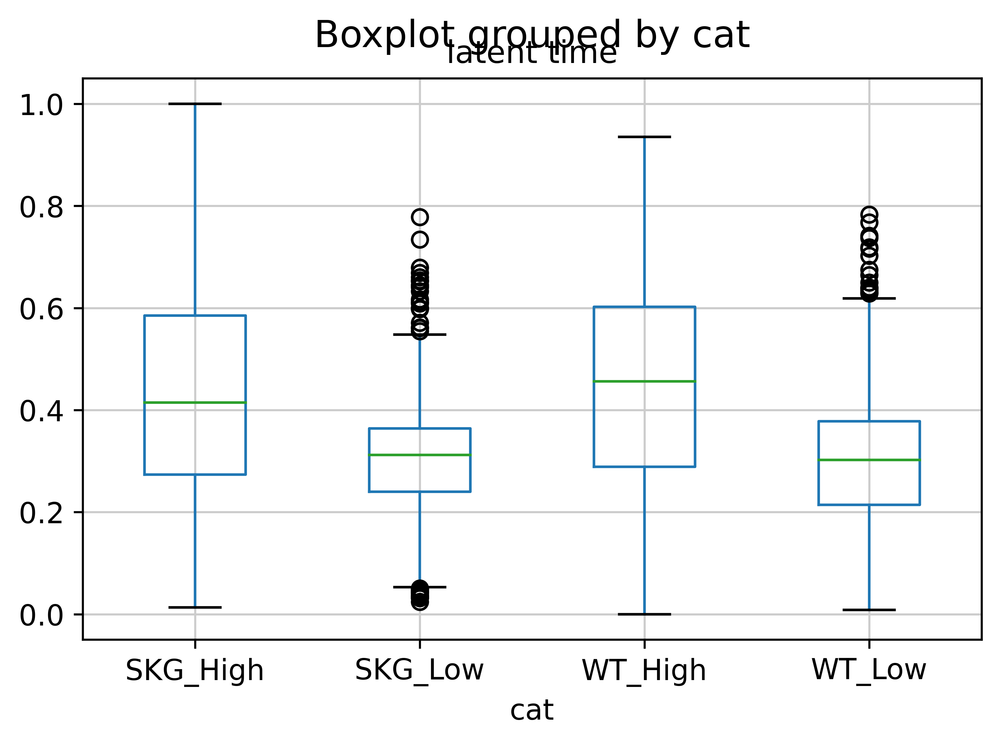

In [52]:
pd.DataFrame.from_dict({'latent time': list(adata_merged_all.obs['latent_time']),'cat': list(adata_merged_all.obs['subgroup'])}).boxplot(column = 'latent time', by = 'cat')

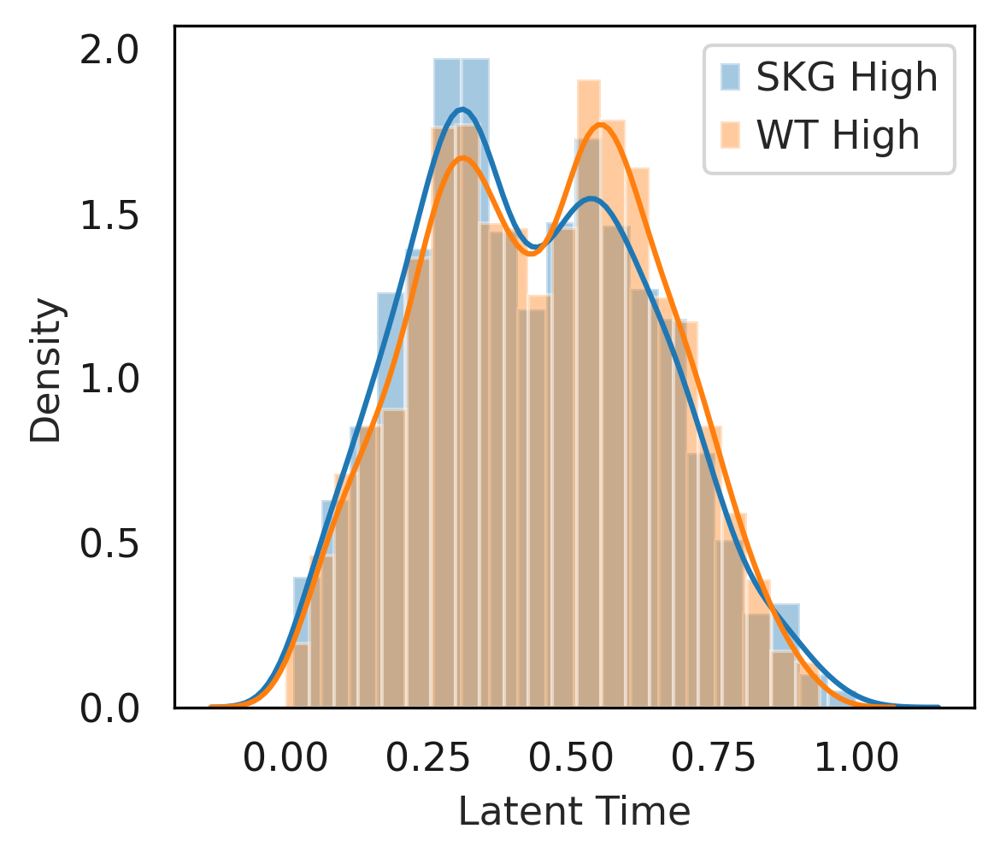

KstestResult(statistic=0.053307771831775735, pvalue=0.002276735419057485)


In [78]:

plt.figure(figsize = (4,3.5))
sample_1 = np.array(adata_merged_all[adata_merged_all.obs['subgroup'] == 'SKG_High'].obs['latent_time'])
sns.distplot(sample_1, kde=True, label = "SKG High", hist = True)

sample_2 = np.array(adata_merged_all[adata_merged_all.obs['subgroup'] == 'WT_High'].obs['latent_time'])
sns.distplot(sample_2, kde=True, label = "WT High", hist = True)

plt.legend()
plt.xlabel("Latent Time")
plt.ylabel("Density")
file_save_prefix = '/wynton/group/ye/emccarthy/EM/judy_proj/proj_2_mouse_T_cell_001/figures/fig_3/'
plt.savefig(file_save_prefix + "fig_3_histogram_latent_time_SKG_High_WT_High.svg", format="svg")
plt.show()
plt.close()
print(scipy.stats.kstest(sample_1,sample_2))

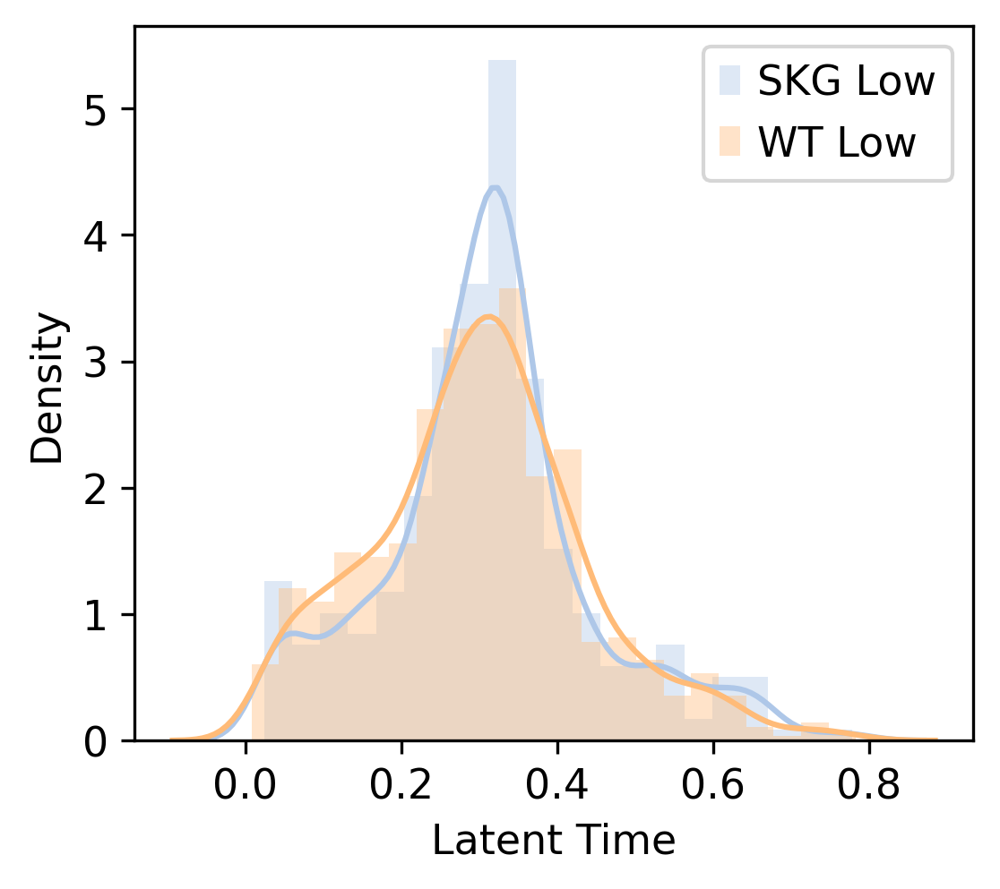

KstestResult(statistic=0.0783122305577243, pvalue=0.10599618441454073)


In [54]:
import seaborn as sns
plt.figure(figsize = (4,3.5))
sample_1 = np.array(adata_merged_all[adata_merged_all.obs['subgroup'] == 'SKG_Low'].obs['latent_time'])
sns.distplot(sample_1, kde=True, label = "SKG Low", color ="#aec7e8" )

sample_2 = np.array(adata_merged_all[adata_merged_all.obs['subgroup'] == 'WT_Low'].obs['latent_time'])
sns.distplot(sample_2, kde=True, label = "WT Low", color =  "#ffbb78" )
plt.legend()
plt.xlabel("Latent Time")
plt.ylabel("Density")
#file_save_prefix = 

#plt.savefig(file_save_prefix + "fig_3_histogram_latent_time_SKG_Low_WT_Low.svg", format="svg")
plt.show()
plt.close()
print(scipy.stats.kstest(sample_1,sample_2))

# Separate stages of latent time distribution with Gaussian Mixture Model

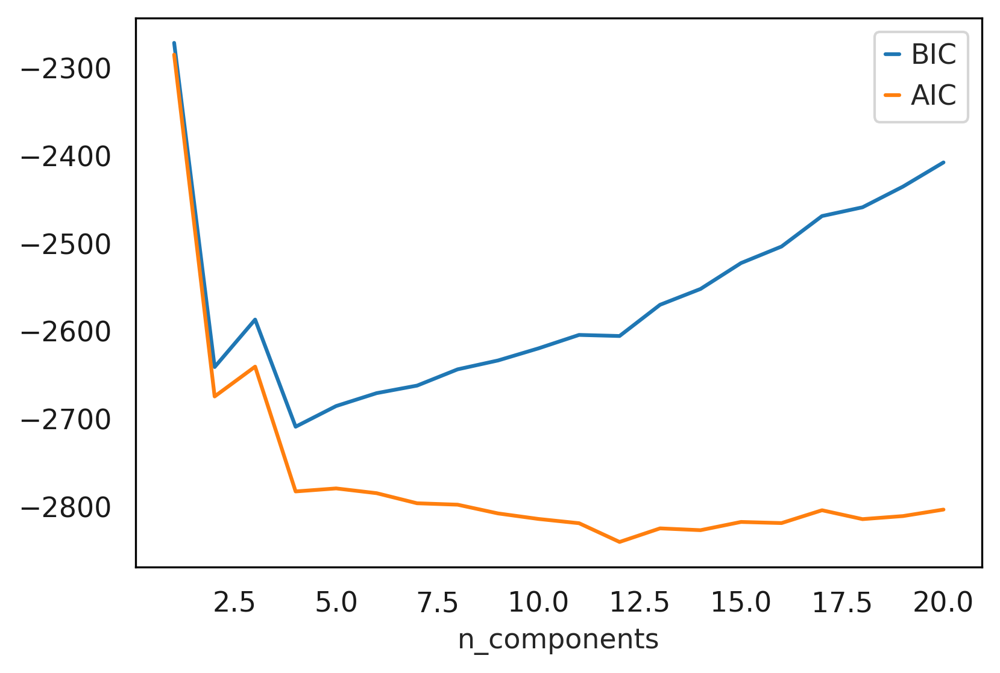

In [15]:
n_components = np.arange(1, 21)
X = np.array(adata_merged_all.obs['latent_time'])
X = X.reshape(-1, 1)
models = [GaussianMixture(n, covariance_type='full', random_state=0).fit(X) for n in n_components]
plt.plot(n_components, [m.bic(X) for m in models], label='BIC')
plt.plot(n_components, [m.aic(X) for m in models], label='AIC')
plt.legend(loc='best')
plt.xlabel('n_components');
#file_save_prefix = 
#plt.savefig(file_save_prefix + "fig_3_line_plot_AIC_BIC_v_n_components.svg", format="svg")
plt.show()
plt.close()

In [11]:
gmm = GaussianMixture(n_components=4)
X = np.array(adata_merged_all.obs['latent_time'])
X = X.reshape(-1, 1)
gmm.fit(X)
labels = gmm.predict(X)

In [12]:
adata_merged_all.obs['Gaussian-4'] = labels

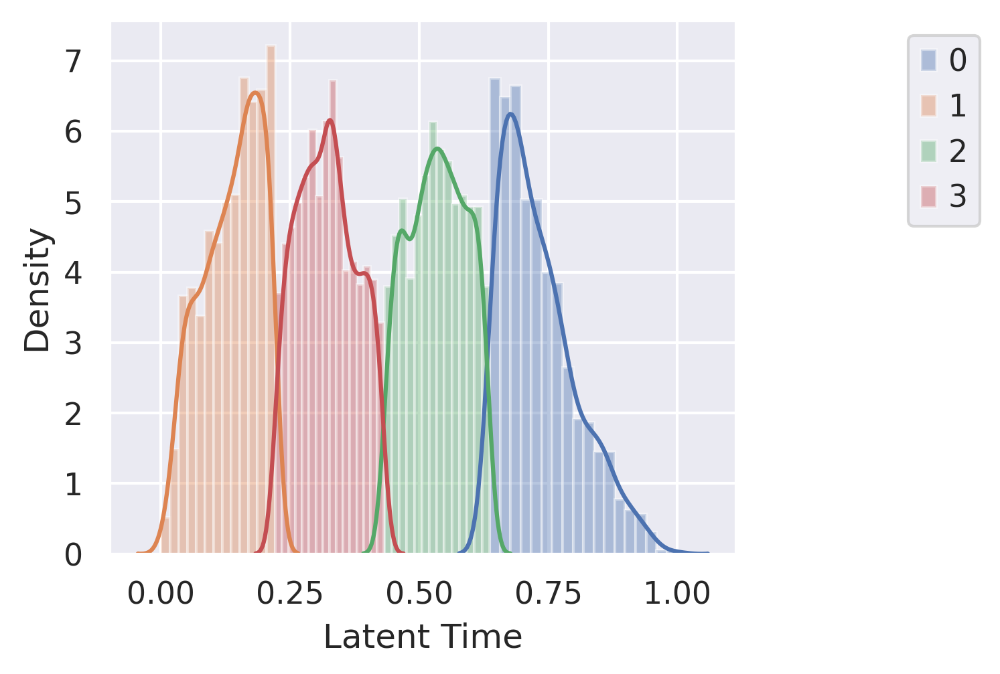

In [13]:

plt.figure(figsize = (4,3.5))
sample_1 = np.array(adata_merged_all[adata_merged_all.obs['Gaussian-4'] == 0].obs['latent_time'])
sns.distplot(sample_1, kde=True, label = "0", hist = True)

sample_2 = np.array(adata_merged_all[adata_merged_all.obs['Gaussian-4'] == 1].obs['latent_time'])
sns.distplot(sample_2, kde=True, label = "1", hist = True)

sample_3 = np.array(adata_merged_all[adata_merged_all.obs['Gaussian-4'] == 2].obs['latent_time'])
sns.distplot(sample_3, kde=True, label = "2", hist = True)

sample_4 = np.array(adata_merged_all[adata_merged_all.obs['Gaussian-4'] == 3].obs['latent_time'])
sns.distplot(sample_4, kde=True, label = "3", hist = True)

plt.legend(bbox_to_anchor=(1.25,1), loc="upper left")
plt.xlabel("Latent Time")
plt.ylabel("Density")

plt.show()
plt.close()

In [14]:
label_dic = {0:'Stage 4',1:'Stage 1',2:'Stage 3',3:'Stage 2'}

In [15]:
adata_merged_all.obs['Gaussian-4-stages'] = [label_dic[x] for x in adata_merged_all.obs['Gaussian-4']]

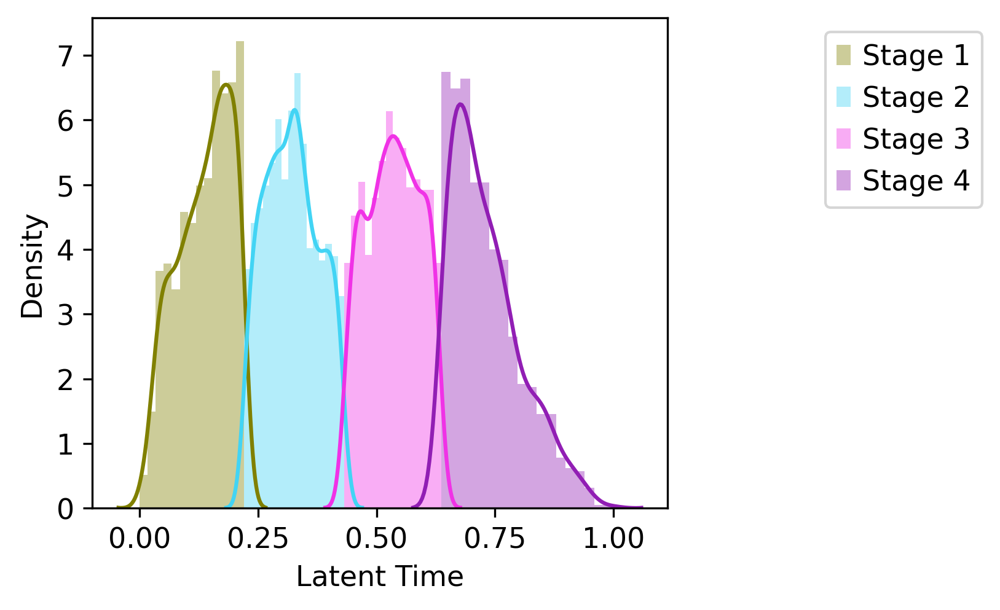

In [33]:
import scipy
plt.figure(figsize = (4,3.5))
sample_1 = np.array(adata_merged_all[adata_merged_all.obs['Gaussian-4-stages'] == 'Stage 1'].obs['latent_time'])
sns.distplot(sample_1, kde=True, label = "Stage 1", hist = True, color = '#808000')

sample_2 = np.array(adata_merged_all[adata_merged_all.obs['Gaussian-4-stages'] == 'Stage 2'].obs['latent_time'])
sns.distplot(sample_2, kde=True, label = "Stage 2", hist = True, color = '#42D4F4')

sample_3 = np.array(adata_merged_all[adata_merged_all.obs['Gaussian-4-stages'] == 'Stage 3'].obs['latent_time'])
sns.distplot(sample_3, kde=True, label = "Stage 3", hist = True, color = '#F032E6')

sample_4 = np.array(adata_merged_all[adata_merged_all.obs['Gaussian-4-stages'] == 'Stage 4'].obs['latent_time'])
sns.distplot(sample_4, kde=True, label = "Stage 4", hist = True, color = '#911EB4')

plt.legend(bbox_to_anchor=(1.25,1), loc="upper left")
plt.xlabel("Latent Time")
plt.ylabel("Density")
#file_save_prefix = 
#plt.savefig(file_save_prefix + "fig_3_histogram_latent_time_by_stage_groupings.svg", format="svg")
plt.show()
plt.close()


In [28]:
adata_merged_all.uns['Gaussian-4-stages_colors'] = ['#808000','#42D4F4','#F032E6','#911EB4']

saving figure to file ./figures/scvelo_fig3_umap_Nr4a1_high_cluster_gaussian_stages.svg


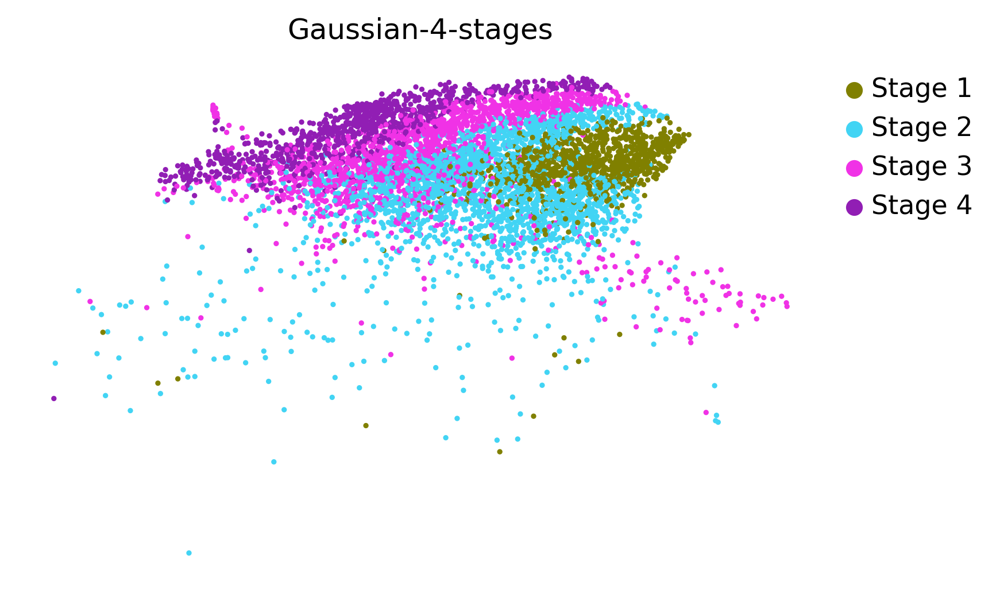

In [13]:
scv.pl.scatter(adata_merged_all, color='Gaussian-4-stages', cmap='gnuplot', save = "fig3_umap_Nr4a1_high_cluster_gaussian_stages.svg")

saving figure to file ./figures/scvelo_fig3_umap_Gaussian_stage_trajectory_overlay.svg


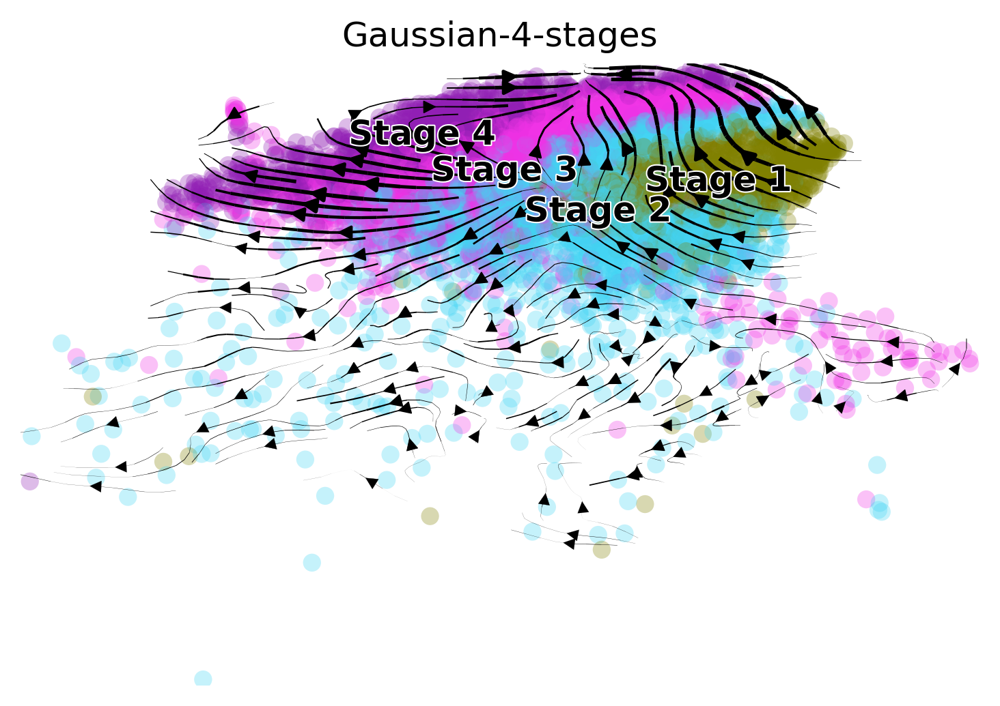

In [16]:
scv.pl.velocity_embedding_stream(adata_merged_all, basis='umap', color = 'Gaussian-4-stages', save = 'fig3_umap_Gaussian_stage_trajectory_overlay.svg')


# Heatmap of expression top genes for modelling latent time

In [25]:
scv.tl.rank_dynamical_genes(adata_merged_all, groupby='cell_types')
df = scv.get_df(adata_merged_all, 'rank_dynamical_genes/names')
df

ranking genes by cluster-specific likelihoods
    finished (0:00:01) --> added 
    'rank_dynamical_genes', sorted scores by group ids (adata.uns)


,3
0,Smc6
1,Sell
2,Txk
3,Gm2682
4,Cd5
...,...
95,Nfkbiz
96,Igfbp4
97,Relb
98,Icos


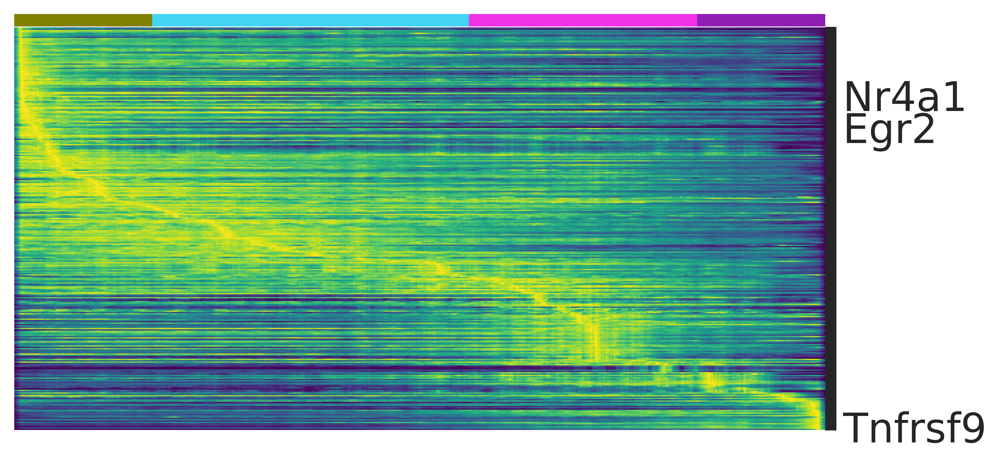

In [29]:
scv.settings.set_figure_params(dpi=300)
labels = [""]*50+["Nr4a1"]+[""]*23 + ["Egr2"] +[""]*222 +["Tnfrsf9"]+[""]*2
top_genes = adata_merged_all.var['fit_likelihood'].sort_values(ascending=False).index[:300]
scv.pl.heatmap(adata_merged_all, var_names=top_genes, sortby='latent_time', col_color='Gaussian-4-stages', n_convolve=100, show = True, yticklabels=labels, colorbar = True, font_scale = 2)#, save = "fig3_heatmap_Gaussian_stages_top_300_genes_marker_gene_names_300_dpi.png")



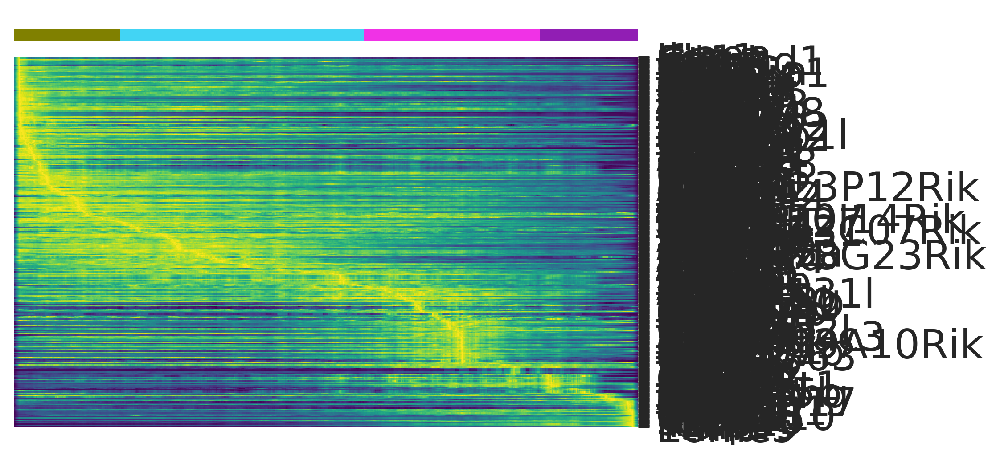

In [38]:
g = scv.pl.heatmap(adata_merged_all, var_names=top_genes, sortby='latent_time', col_color='Gaussian-4-stages', n_convolve=100, show = False, yticklabels=True, colorbar = True, font_scale = 2)#, save = "fig3_heatmap_Gaussian_stages_top_300_genes_marker_gene_names_300_dpi.png")


In [40]:
def min_max_scaling(df):
    # copy the dataframe
    df_norm = df.copy()
    # apply min-max scaling
    for index in df_norm.index:
        df_norm.loc[index] = (df_norm.loc[index] - df_norm.loc[index].min()) / (df_norm.loc[index].max()- df_norm.loc[index].min())
        
    return df_norm
    
# call the min_max_scaling function
adata_df_subset_t_norm = min_max_scaling(adata_df_subset_t)

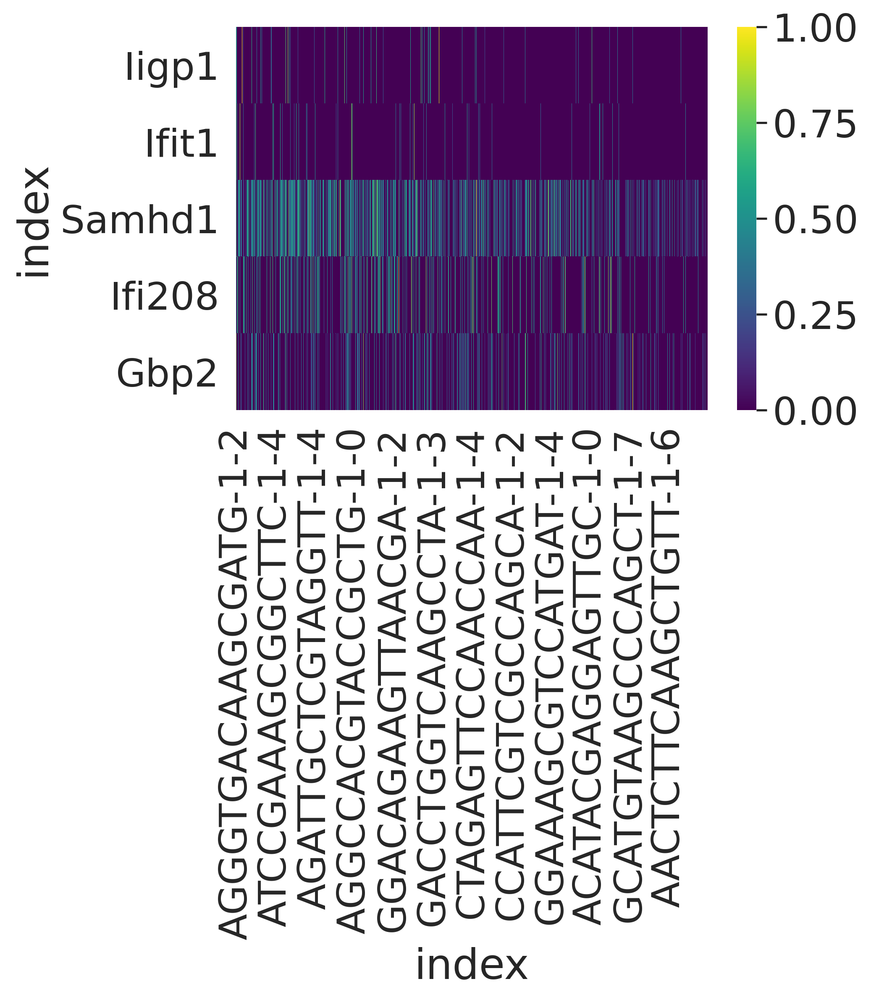

In [41]:
#To get heatmap legend color bar

ordered_genes = [x.get_text() for x in g.ax_heatmap.get_yticklabels()]

adata_df = pd.DataFrame(adata_merged_all.raw.X.todense(), index = adata_merged_all.obs.index, columns = adata_merged_all.raw.var_names)
adata_df_subset = adata_df.loc[:,ordered_genes]
adata_df_subset.loc[:,'latent_time'] = adata_merged_all.obs['latent_time']
adata_df_subset = adata_df_subset.sort_values('latent_time').iloc[:,0:300]
adata_df_subset_t = adata_df_subset.T

adata_df_subset_t_norm = min_max_scaling(adata_df_subset_t)
fig = sns.heatmap(adata_df_subset_t_norm.iloc[0:5,:], cmap = 'viridis')


In [48]:
#Save ordered gene list

output_file=open('results/single_cell_RNA_seq/trajectory/data_S7_top_300_heatmap_gene_list.tsv','w')

ordered_genes_to_save = [str(i+1) + "\t" + line + '\n' for i, line in enumerate(ordered_genes)]
#ordered_genes_to_save=map(lambda x:x+'\n',ordered_genes)
output_file.writelines(ordered_genes_to_save)
output_file.close()

# Differential expression between Stage 1 and Stage 4

In [9]:
adata_RNA_Nr4a1_cluster = adata_RNA[adata_merged_all.obs.index]

#adata_RNA_Nr4a1_cluster.write('/wynton/group/ye/emccarthy/EM/judy_proj/proj_2_mouse_T_cell_001/adata_only_T_cells_Nr4a1_cluster_with_stages.h5ad')

In [4]:
adata_RNA_Nr4a1_cluster = sc.read('/wynton/group/ye/emccarthy/EM/judy_proj/proj_2_mouse_T_cell_001/adata_only_T_cells_Nr4a1_cluster_with_stages.h5ad')

In [5]:
adata_RNA_Nr4a1_cluster

AnnData object with n_obs × n_vars = 6041 × 1119
    obs: 'GFP', 'RBC', 'batch', 'genotype', 'mouse', 'n_counts', 'n_genes', 'percent_mito', 'platelet', 'louvain', 'leiden', 'GFP_category', 'subgroup', 'umap_density_subgroup', 'cell_type', 'TRBV', 'Gaussian-4-stages'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'barcodes', 'batch_colors', 'genes', 'leiden', 'leiden_colors', 'louvain', 'louvain_colors', 'neighbors', 'pca', 'rank_genes_groups', 'raw_counts', 'umap_density_subgroup_params'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [10]:
adata_RNA_Nr4a1_cluster.obs['Gaussian-4-stages'] = adata_merged_all.obs['Gaussian-4-stages']

Trying to set attribute `.obs` of view, copying.


In [6]:
adata_subset_diff_genes = adata_RNA_Nr4a1_cluster[[x in ['Stage 1', 'Stage 4'] for x in adata_RNA_Nr4a1_cluster.obs['Gaussian-4-stages']]]

In [7]:
sc.tl.rank_genes_groups(adata_subset_diff_genes, 'Gaussian-4-stages', n_genes = len(adata_RNA_Nr4a1_cluster.raw.var_names), use_raw=True, groups='all',
                           reference='rest', rankby_abs=False, key_added=None,
                           copy=False, method='wilcoxon',
                           corr_method='benjamini-hochberg', log_transformed=True, pts = True)


Trying to set attribute `.uns` of view, copying.


In [13]:
cluster = 'Stage 1'
names = np.array(adata_subset_diff_genes.uns['rank_genes_groups']['names'][cluster])
logfoldchanges = np.array(adata_subset_diff_genes.uns['rank_genes_groups']['logfoldchanges'][cluster])
p_val = np.array(adata_subset_diff_genes.uns['rank_genes_groups']['pvals'][cluster])

In [14]:
df_1 = pd.DataFrame.from_dict({'gene':names, 'log_fold_change':logfoldchanges, 'p_value':p_val})
df_1.index = df_1['gene']

In [15]:
nr4a1_df_subset = pd.read_csv('results/single_cell_RNA_seq/differential_expression/data_S5_diff_genes_Nr4a1_high_cluster_versus_other_cells.csv')
nr4a1_df_subset.index =  nr4a1_df_subset['gene']
min_cutoff = 0.01
nr4a1_df_subset_2 = nr4a1_df_subset[[x > min_cutoff for x in nr4a1_df_subset['T.4N_Nr4a1_percent']]]

In [43]:
df_1_subset = df_1.loc[nr4a1_df_subset_2.index ,:]
df_1_subset["rank"] = np.sign(df_1_subset["log_fold_change"]) * -np.log10(df_1_subset["p_value"])

df_1_subset = df_1_subset.sort_values('rank', ascending = False)
df_1_subset.loc[:,['gene','rank']].to_csv('results/single_cell_RNA_seq/Nr4a1_cluster_stage_1_v_stage_4.rnk', index = False, sep = "\t")

In [11]:
cluster = 'Stage 1'
names = np.array(adata_subset_diff_genes.uns['rank_genes_groups']['names'][cluster])
logfoldchanges = np.array(adata_subset_diff_genes.uns['rank_genes_groups']['logfoldchanges'][cluster])
adj_p_val = np.array(adata_subset_diff_genes.uns['rank_genes_groups']['pvals_adj'][cluster])

In [14]:
df_2 = pd.DataFrame.from_dict({'gene':names, 'log_fold_change':logfoldchanges, 'adj_p_value':adj_p_val})
df_2.index = df_2['gene']
df_2.to_csv('results/single_cell_RNA_seq/Nr4a1_cluster_stage_1_v_stage_4.csv', index = False)

# Visualize smoothed gene expression over latent time

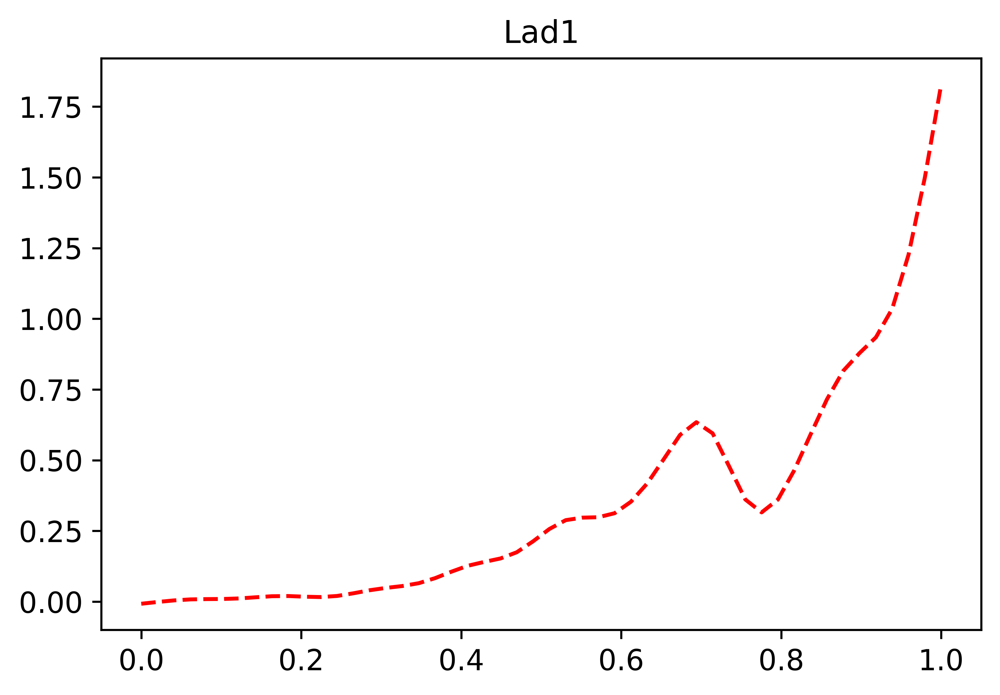

In [17]:
gene = 'Lad1'
X = list(np.array(adata_merged_all.obs['latent_time']))
y = list(np.array(adata_merged_all.raw[:,gene].X.todense()).ravel())
model = LinearGAM(fit_intercept = False).fit(X, y)

XX = np.linspace(0,1,50)

#plots for vizualisation
plt.plot(XX, model.predict(XX), 'r--')
#plt.plot(XX, model.prediction_intervals(XX,width=0.25), color='b', ls='--    ')
#plt.scatter(X, y)
plt.title(gene)
#file_save_prefix = 
#plt.savefig(file_save_prefix + "fig_3_smoothed_gene_exp_by_latent_time"+gene+".svg", format="svg")
plt.show()
plt.close()


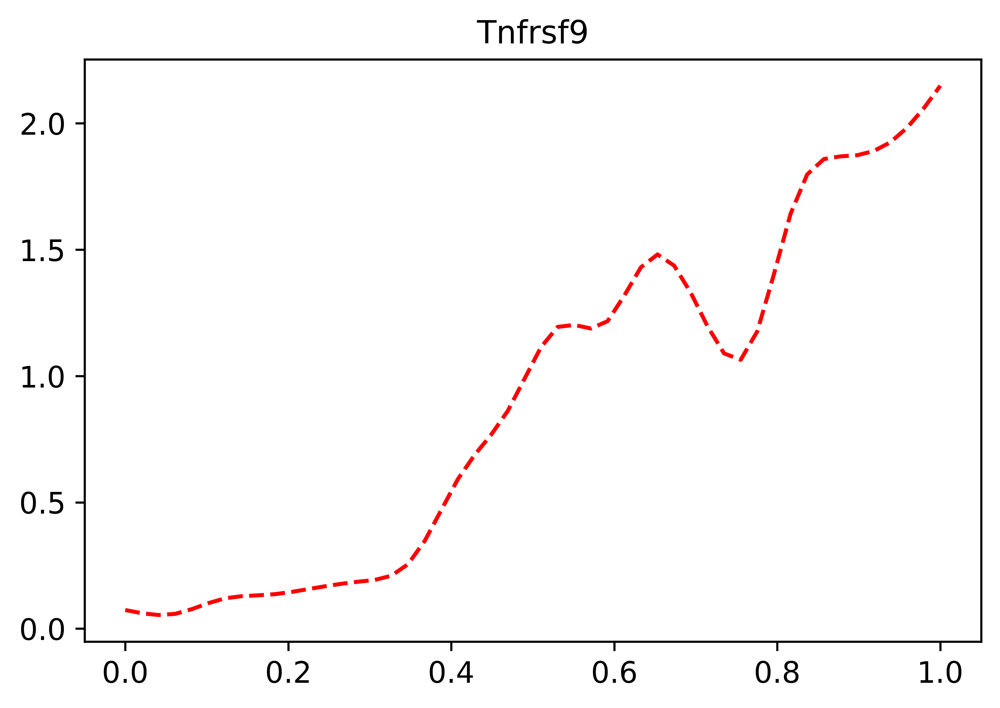

In [18]:
gene = 'Tnfrsf9'
X = list(np.array(adata_merged_all.obs['latent_time']))
y = list(np.array(adata_merged_all.raw[:,gene].X.todense()).ravel())
model = LinearGAM(fit_intercept = False).fit(X, y)

XX = np.linspace(0,1,50)

#plots for vizualisation
plt.plot(XX, model.predict(XX), 'r--')
#plt.plot(XX, model.prediction_intervals(XX,width=0.25), color='b', ls='--    ')
#plt.scatter(X, y)
plt.title(gene)
#file_save_prefix 
#plt.savefig(file_save_prefix + "fig_3_smoothed_gene_exp_by_latent_time"+gene+".svg", format="svg")
plt.show()
plt.close()

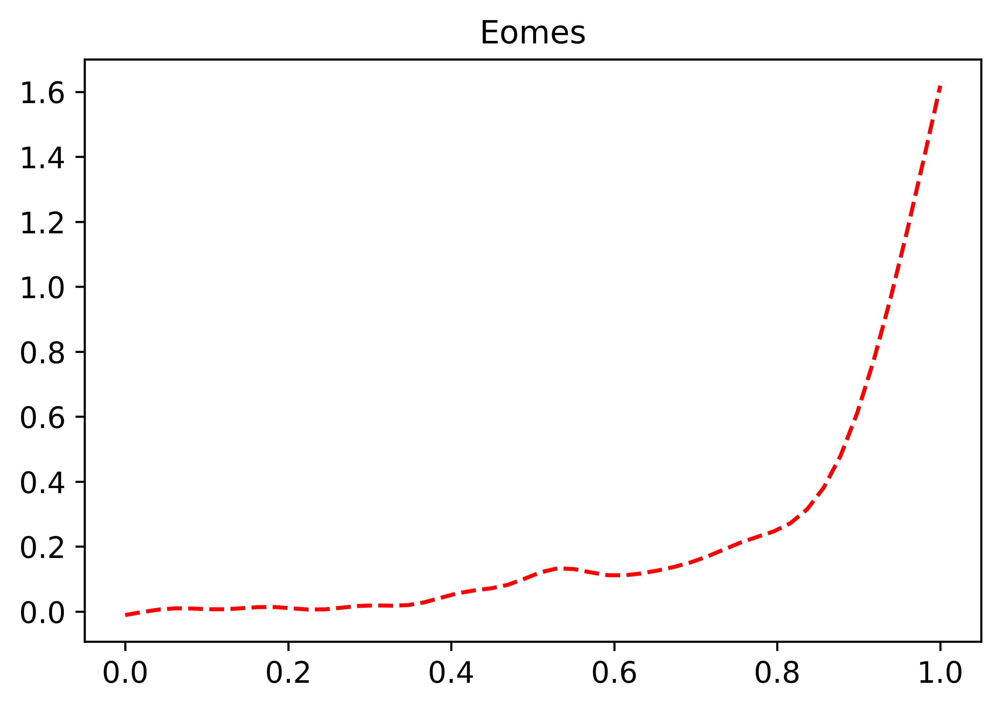

In [19]:
gene = 'Eomes'
X = list(np.array(adata_merged_all.obs['latent_time']))
y = list(np.array(adata_merged_all.raw[:,gene].X.todense()).ravel())
model = LinearGAM(fit_intercept = False).fit(X, y)

XX = np.linspace(0,1,50)

#plots for vizualisation
plt.plot(XX, model.predict(XX), 'r--')
#plt.plot(XX, model.prediction_intervals(XX,width=0.25), color='b', ls='--    ')
#plt.scatter(X, y)
plt.title(gene)
#file_save_prefix = 
#plt.savefig(file_save_prefix + "fig_3_smoothed_gene_exp_by_latent_time"+gene+".svg", format="svg")
plt.show()
plt.close()

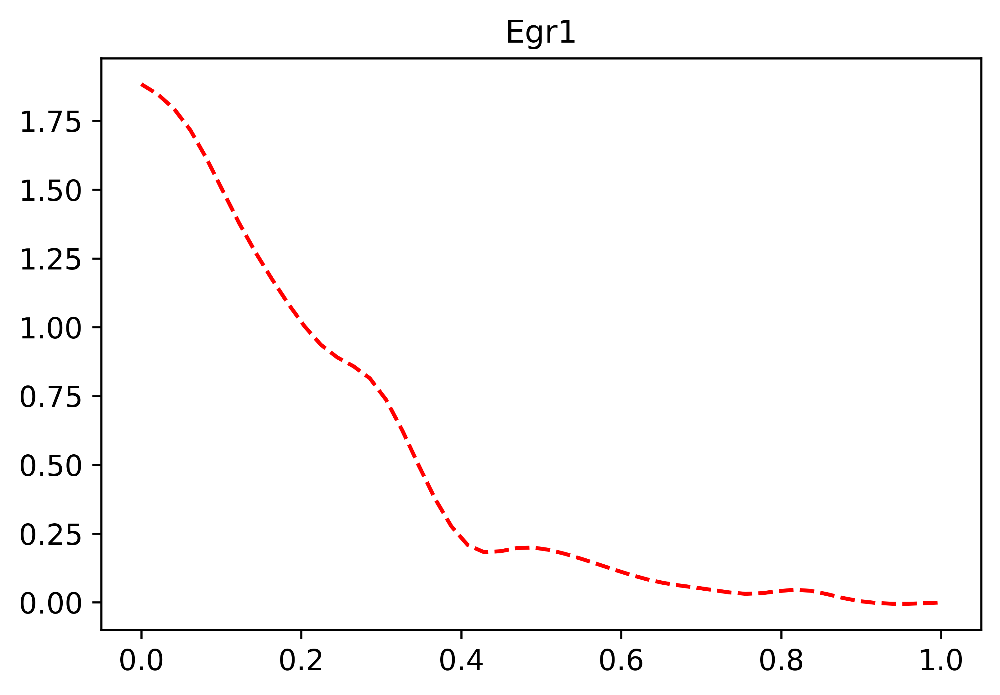

In [20]:
gene = 'Egr1'
X = list(np.array(adata_merged_all.obs['latent_time']))
y = list(np.array(adata_merged_all.raw[:,gene].X.todense()).ravel())
model = LinearGAM(fit_intercept = False).fit(X, y)

XX = np.linspace(0,1,50)

#plots for vizualisation
plt.plot(XX, model.predict(XX), 'r--')
#plt.plot(XX, model.prediction_intervals(XX,width=0.25), color='b', ls='--    ')
#plt.scatter(X, y)
plt.title(gene)
#file_save_prefix = 
#plt.savefig(file_save_prefix + "fig_3_smoothed_gene_exp_by_latent_time"+gene+".svg", format="svg")
plt.show()
plt.close()

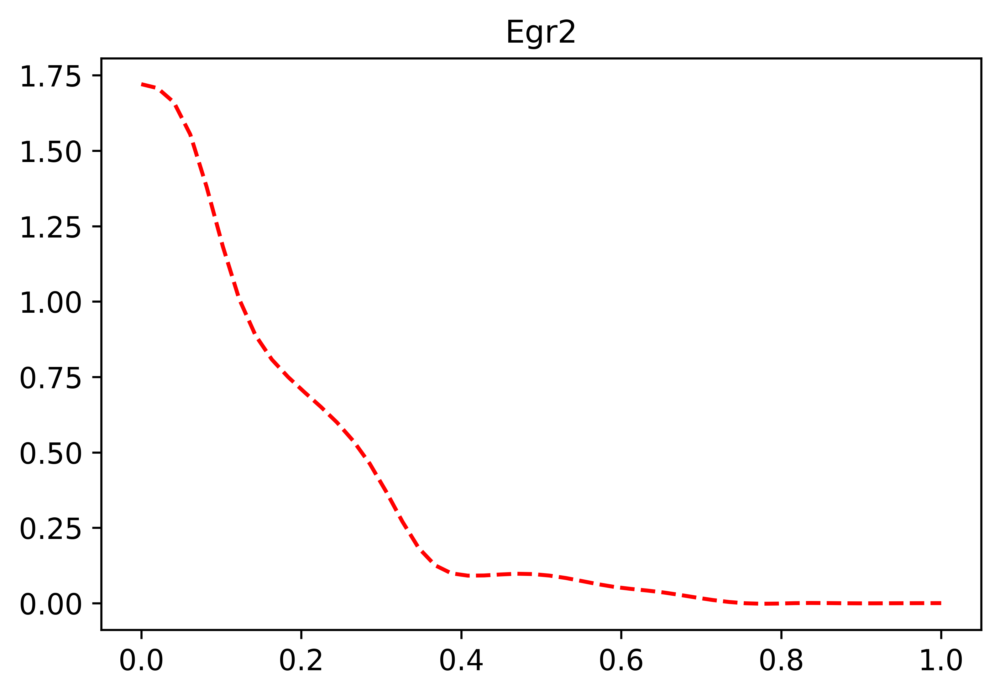

In [21]:
gene = 'Egr2'
X = list(np.array(adata_merged_all.obs['latent_time']))
y = list(np.array(adata_merged_all.raw[:,gene].X.todense()).ravel())
model = LinearGAM(fit_intercept = False).fit(X, y)

XX = np.linspace(0,1,50)

#plots for vizualisation
plt.plot(XX, model.predict(XX), 'r--')
#plt.plot(XX, model.prediction_intervals(XX,width=0.25), color='b', ls='--    ')
#plt.scatter(X, y)
plt.title(gene)
#file_save_prefix = 
#plt.savefig(file_save_prefix + "fig_3_smoothed_gene_exp_by_latent_time"+gene+".svg", format="svg")
plt.show()
plt.close()

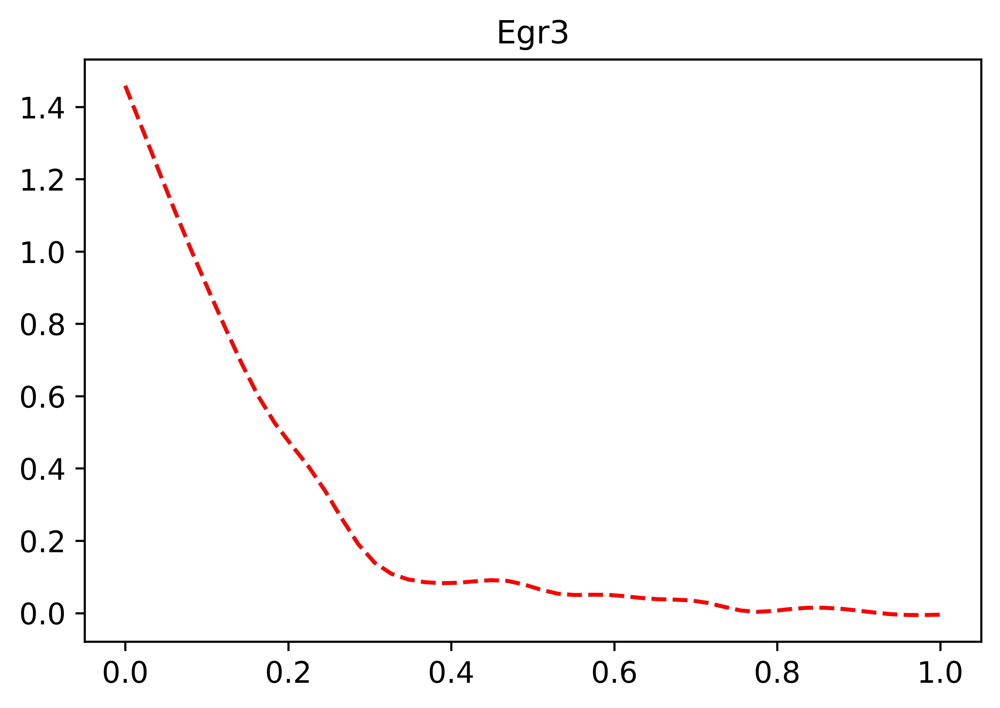

In [22]:
gene = 'Egr3'
X = list(np.array(adata_merged_all.obs['latent_time']))
y = list(np.array(adata_merged_all.raw[:,gene].X.todense()).ravel())
model = LinearGAM(fit_intercept = False).fit(X, y)

XX = np.linspace(0,1,50)

#plots for vizualisation
plt.plot(XX, model.predict(XX), 'r--')
#plt.plot(XX, model.prediction_intervals(XX,width=0.25), color='b', ls='--    ')
#plt.scatter(X, y)
plt.title(gene)
#file_save_prefix = 
#plt.savefig(file_save_prefix + "fig_3_smoothed_gene_exp_by_latent_time"+gene+".svg", format="svg")
plt.show()
plt.close()

# Run PAGA

In [59]:
#!pip install python-igraph --upgrade --quiet

In [62]:
#!pip install jinja2 --upgrade --quiet

In [31]:
adata_merged_all.uns['neighbors']['distances'] = adata_merged_all.obsp['distances']
adata_merged_all.uns['neighbors']['connectivities'] = adata_merged_all.obsp['connectivities']

scv.tl.paga(adata_merged_all, groups='Gaussian-4-stages')
df = scv.get_df(adata_merged_all, 'paga/transitions_confidence', precision=2).T
df.style.background_gradient(cmap='Blues').format('{:.2g}')

running PAGA
    finished (0:00:04) --> added
    'paga/transitions_confidence', connectivities adjacency (adata.uns)
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)


,0,1,2,3
0,0,1.2,0,0
1,0,0,1.4,0
2,0,0,0,2
3,0,0,0,0


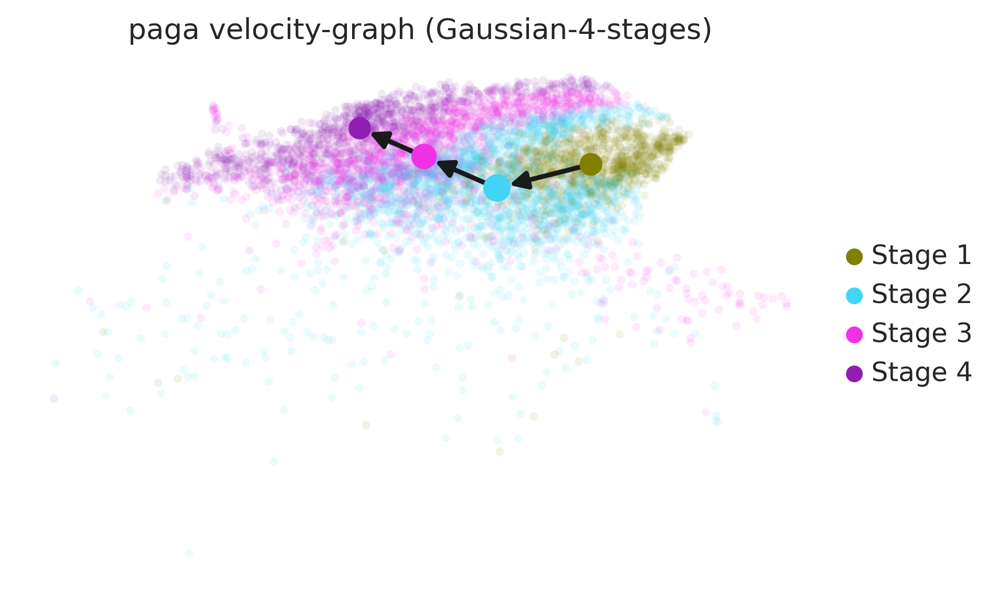

In [32]:
scv.settings.set_figure_params(dpi=150)
scv.pl.paga(adata_merged_all, basis='umap', size=50, alpha=.1,
            min_edge_width=2, node_size_scale=0.5)

# Save adata object

In [44]:
print(adata_merged_all)
path = 'adata_object/'
adata_file = path + 'single_cell_scvelo_T_4_Nr4a1_cluster.h5ad'
adata_merged_all.write(adata_file)

AnnData object with n_obs × n_vars = 6041 × 840
    obs: 'GFP', 'RBC', 'batch', 'genotype', 'mouse', 'n_counts', 'n_genes', 'percent_mito', 'platelet', 'louvain', 'leiden', 'GFP_category', 'subgroup', 'umap_density_subgroup', 'cell_type', 'initial_size_unspliced', 'initial_size_spliced', 'initial_size', 'velocity_self_transition', 'root_cells', 'end_points', 'velocity_pseudotime', 'latent_time', 'Tnf_cat', 'Tnf_Egr_cat', 'velocity_length', 'velocity_confidence', 'velocity_confidence_transition', 'Gaussian-4-stages', 'cell_types'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'fit_r2', 'fit_alpha', 'fit_beta', 'fit_gamma', 'fit_t_', 'fit_scaling', 'fit_std_u', 'fit_std_s', 'fit_likelihood', 'fit_u0', 'fit_s0', 'fit_pval_steady', 'fit_steady_u', 'fit_steady_s', 'fit_variance', 'fit_alignment_scaling', 'velocity_genes', 'spearmans_score', 'velocity_score'
    uns: 'Tnf_Egr